In [1]:
# the hub-genes were loaded from the kME file generated from the WGCNA analysis
# miRNA targeting database was used and created
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
plt.rc('xtick', labelsize=15)
plt.rc('ytick', labelsize=15)

# Detect all the hub-genes with a kME above 0.8 shared in all three cell lines

In [27]:
#load the data
hub_genes = pd.read_csv("/Users/maximilianzeidler/Dropbox/iPSC/Notebooks/consensusAnalysis-CombinedNetworkResults_filtered_power20.csv") #WGCNA hub-gene analysis
mrna_genes = pd.read_csv("/Users/maximilianzeidler/Dropbox/iPSC/Notebooks/Supercluster_iPSC_network_mRNA_all_zelllines.csv") # trajectories for merged three cell lines
mrna_genes = mrna_genes.set_index("external_gene_name")
mirna = pd.read_csv("/Users/maximilianzeidler/Dropbox/iPSC/Notebooks/miR_superclustering.csv") # miRNA trajectories 
chord_diagram = pd.read_csv("/Users/maximilianzeidler/Dropbox/iPSC/Notebooks/mirna_edges.csv") # miRNA::mRNA database constructed from Network construction ipynb
plt.rcParams['svg.fonttype'] = 'none'
chord_diagram["gene_name"].unique()

array(['A1BG', 'ABHD2', 'ACBD5', ..., 'UNC13B', 'USH1G', 'ZNF488'],
      dtype=object)

In [31]:
# use the genes list
# determine the hub-genes based on the kME, hub-genes above 0.8 kME were selected
genes_liste = list(set(hub_genes["ModuleColor"].tolist()))


def get_hub_networks_last_network(df, expression, cluster_liste):
    all_module_hubs = pd.DataFrame()
    for i in cluster_liste:
        hub_genes_module = hub_genes[hub_genes["ModuleColor"] == i]
        cl = str(hub_genes_module["ModuleLabel"].tolist()[0])
        if cl == "0":
            print(hub_genes_module)
        else:
            trial = hub_genes_module[[
                "external_gene_name", "gene_biotype", "kME.set1.ME" + cl,
                "kME.set2.ME" + cl, "kME.set3ME" + cl, "p.kME.set1.ME" + cl,
                "p.kME.set2.ME" + cl, "p.kME.set3ME" + cl
            ]]
            
            trial = trial[(trial["kME.set1.ME" + cl] > 0.8)
                          & (trial["kME.set2.ME" + cl] > 0.8) &
                          (trial["kME.set3ME" + cl] > 0.8)]
            
            trial.columns = [
                "external_gene_name", "gene_biotype", "kME.set1.ME",
                "kME.set2.ME", "kME.set3ME", "p.kME.set1.ME", "p.kME.set2.ME",
                "p.kME.set3ME"
            ]
            trial["Module"] = trial.shape[0] * [i]
            trial = trial.sort_values(
                ["kME.set1.ME", "kME.set2.ME", "kME.set3ME"], ascending=False)
            all_module_hubs = all_module_hubs.append(trial)
    return all_module_hubs


module_hubs = get_hub_networks_last_network(hub_genes, mrna_genes, genes_liste)
module_hubs

       Unnamed: 0            Probe  ModuleLabel ModuleColor  kME.set1.ME0  \
27             28  ENSG00000003056            0        grey      0.573114   
52             53  ENSG00000004779            0        grey     -0.638177   
120           121  ENSG00000006576            0        grey      0.553272   
152           153  ENSG00000007376            0        grey     -0.723263   
157           158  ENSG00000007520            0        grey     -0.352941   
...           ...              ...          ...         ...           ...   
20810       20811  ENSG00000287710            0        grey     -0.196052   
20842       20843  ENSG00000287896            0        grey     -0.229441   
20869       20870  ENSG00000288066            0        grey     -0.783686   
20877       20878  ENSG00000288438            0        grey      0.235773   
20878       20879  ENSG00000288442            0        grey      0.373237   

       kME.set2.ME0  kME.set3ME0  p.kME.set1.ME0  p.kME.set2.ME0  \
27     

,external_gene_name,gene_biotype,kME.set1.ME,kME.set2.ME,kME.set3ME,p.kME.set1.ME,p.kME.set2.ME,p.kME.set3ME,Module
4967,BCL2L12,protein_coding,0.991404,0.987818,0.973424,1.458732e-15,2.347662e-14,1.151311e-11,black
15957,LINC00665,lncRNA,0.990496,0.980321,0.940492,3.247761e-15,1.063447e-12,6.554910e-09,black
2142,SALL4,protein_coding,0.989940,0.968792,0.960375,5.110307e-15,4.102101e-11,2.698553e-10,black
7181,CAMKMT,protein_coding,0.983820,0.947597,0.942347,2.244595e-13,2.424459e-09,5.117993e-09,black
3333,LTA4H,protein_coding,0.983236,0.984629,0.985570,2.976687e-13,1.493510e-13,9.036689e-14,black
...,...,...,...,...,...,...,...,...,...
11648,ZNF354C,protein_coding,0.813411,0.942791,0.884208,4.038421e-05,4.817855e-09,1.123310e-06,darkgrey
2254,MIB1,protein_coding,0.807236,0.886442,0.939926,5.131904e-05,9.681879e-07,7.057261e-09,darkgrey
14431,AC078899.1,processed_pseudogene,0.806064,0.866737,0.966176,5.365652e-05,3.264817e-06,7.746143e-11,darkgrey
9323,ZDHHC3,protein_coding,0.804804,0.822314,0.833516,5.626967e-05,2.814038e-05,1.735248e-05,darkgrey


In [32]:
#get top 5 hub-genes per module
module_hubs["mean_kme"] = module_hubs.iloc[:, 2:5].mean(axis=1)

def top_modules(df):
    """ get the top hubs - top 5 to save as csv and present astable for paper"""
    all_hubs = pd.DataFrame()
    for i in set(df["Module"]):
        df_module = df[df["Module"] == i].sort_values(
            "mean_kme", ascending=False).iloc[0:5]
        all_hubs = all_hubs.append(df_module)
    return all_hubs


top_hubs = top_modules(module_hubs)
#top_hubs.to_csv("top_hub_genes.csv")
#uncomment to save

In [3]:
# here we dissect functionality of modules
module_neuron = pd.read_csv("module_networks_neuron.csv", delimiter="\t")
module_neuron.columns = ["source", "target"]

def network_function(df):
    """ draw the network for hub-genes based on correlations
    df --> neuron related modules dataframe  from wgcna analysis"""
    n_n = nx.from_pandas_edgelist(df, "source", "target")
    fig, ax = plt.subplots(figsize=(7, 7))
    degree = n_n.degree()
    values = [t for i, t in degree]
    print(values)
    nx.draw_kamada_kawai(n_n,
                         with_labels=True,
                         node_size=[i * 150 for i in values],
                         font_size=15) # kamada kawai layout
    plt.tight_layout()
    plt.savefig("network_neuron_related_module.svg",
                quality=90,
                transparent=True,
                dpi=600)


network_function(module_neuron)

FileNotFoundError: [Errno 2] File /home/physiologie/Dropbox/iPSC/Notebooks/module_networks_neuron.csv does not exist: '/home/physiologie/Dropbox/iPSC/Notebooks/module_networks_neuron.csv'

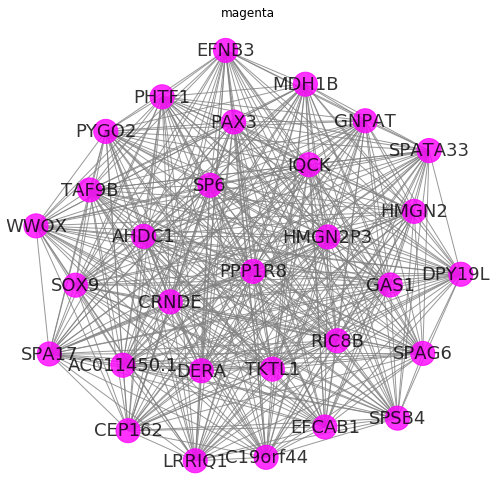

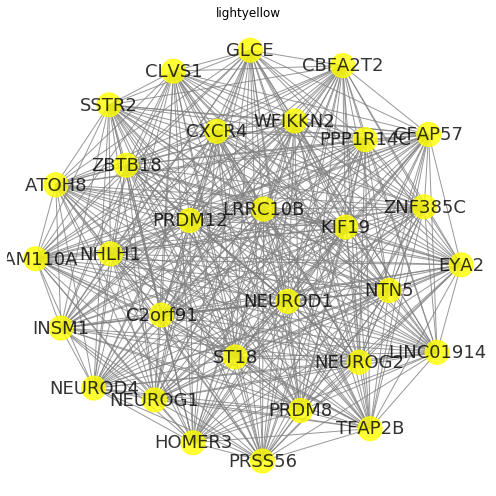

In [4]:
#search for the networks of interest here -> draw network and set the color of the network
neuronal_networks_liste_outgrowth = ["yellow", "red", "floralwhite", "violet", "royalblue", "lightcyan"]
neuronal_networks_ion_channels = ["saddlebrown", "cyan", "grey60", "brown"]
development = ["magenta","lightyellow"]
color_outgrowth = [ "yellow", "red", "ivory", "violet", "royalblue", "lightcyan"]
color_ion = ["saddlebrown", "cyan", "grey", "brown"]
color_development = ["magenta","yellow"]


def get_module_networks(expression, all_hubs, modules, colors):
    """
    expression -> trajectories of mRNA for correlation analysis
    all_hubs -> constrain for hub-genes
    modules -> the choosen modules you want to draw
    colors -> select the color of the module
    """
    for i, t in zip(modules, colors):
        module_hubs = all_hubs[all_hubs["Module"] == i].iloc[:30, :]["external_gene_name"].tolist()
        module_expression = expression[expression.index.isin(module_hubs)].iloc[:, 3:-1]
        module_corr = module_expression.T.corr()
        stack_module = pd.DataFrame(module_corr.stack())
        stack_module.index.set_names(["source", "target"], inplace=True)
        stack_module = stack_module.reset_index()
        stack_module.columns = ["source", "target", "score"] # set the columns
        stack_module = stack_module[stack_module["score"] != 1] #remove genes correlation with themself
        
        
        fig, ax = plt.subplots(figsize=(7, 7))
        module_net = nx.from_pandas_edgelist(stack_module, "source", "target", "score")
        degree = module_net.degree()
        values = [t for i, t in degree]
        nx.draw_spring(module_net,
                       with_labels=True,
                       node_color=t,
                       node_size=[i * 20 for i in values],
                       edge_color="grey",
                       font_size=18,
                       alpha=0.8)
        plt.title(i)
        plt.tight_layout()
        plt.savefig(i + "_outgrowth_module_hubs.svg",
                    dpi=600,
                    transparent=True,
                    quality=90,
                    bbox_inches="tight")


#get_module_networks(mrna_genes, module_hubs, neuronal_networks_liste_outgrowth, color_outgrowth)
get_module_networks(mrna_genes, module_hubs, development,
                    color_development)

In [39]:
#target score set to
from sklearn.decomposition import PCA
import seaborn as sns
import umap


# Construct the distance matrix based on the miRNA::mRNA interaction score
hub_chord = chord_diagram[chord_diagram["gene_name"].isin(
    module_hubs["external_gene_name"].tolist())]
hub_chord = hub_chord[(hub_chord["score"] > 70)
                      & (hub_chord["correlation"] < -0.7)] # constrained to target score and correlation

distant_matrix = hub_chord[["gene_name", "mirna", "score"]]
dist = distant_matrix.groupby(["gene_name", "mirna"]).agg("mean").unstack()
dist = dist.fillna(0)
dist.to_csv("distance_matrix_mirna_gene.csv")

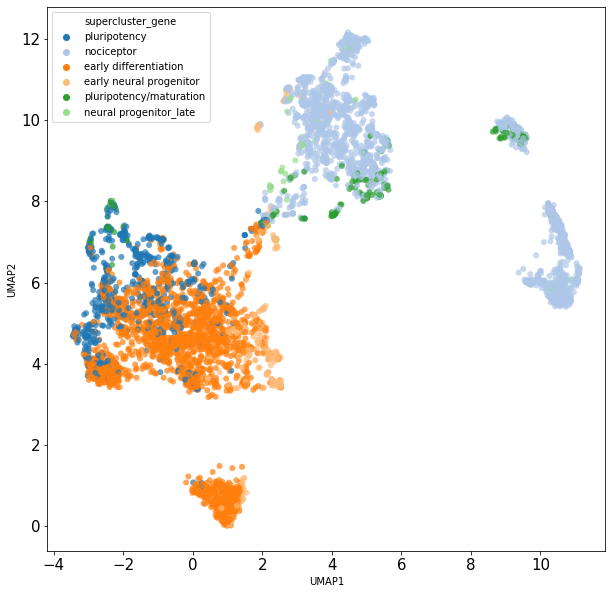

In [42]:
#draw the umap of the adjacency matrix of similar microRNA interactions, inheriently sparse matrix
super_cluster = hub_chord[["gene_name", "supercluster_gene",
                           "cluster_gene"]].drop_duplicates()


#since all miRNAs gene interactino are in equal range no scaling applied

mapper = umap.UMAP(n_neighbors=20,
                   min_dist=0.05,
                   n_components=2,
                   metric="manhattan",
                   random_state = 43).fit_transform(dist.values) #manhattan function distance used here
dataframe = pd.DataFrame(mapper, columns=["UMAP1", "UMAP2"], index=dist.index)
dataframe_end = pd.merge(dataframe,
                         super_cluster,
                         how="left",
                         left_index=True,
                         right_on="gene_name")

fig, ax = plt.subplots(figsize=(10, 10))
sns.scatterplot(data=dataframe_end,
                x="UMAP1",
                y="UMAP2",
                linewidth=0,
                hue="supercluster_gene",
                palette="tab20",
                alpha=0.7
               )
#plt.savefig("UMAP_genes_mirna.svg", quality=90, transparent=True, dpi=600)

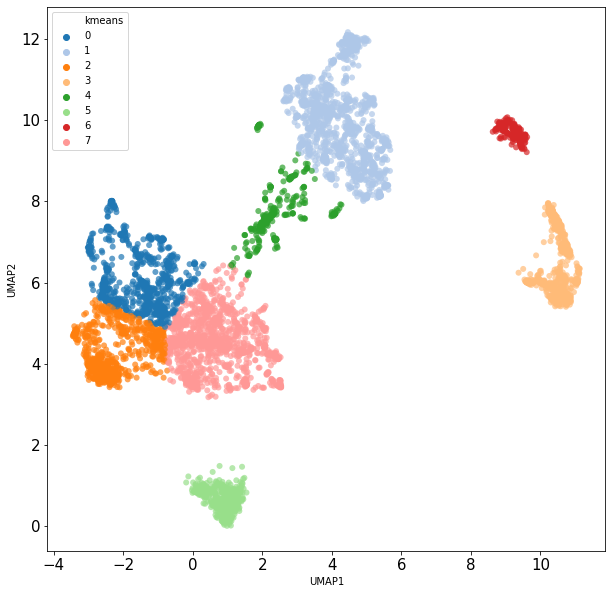

In [43]:
from sklearn.cluster import KMeans
#determine kmeans cluster
kmeans = KMeans(n_clusters=8, random_state=0).fit(mapper) #biased number of cluster for overview purposes
dataframe_end["kmeans"] = kmeans.labels_

fig, ax = plt.subplots(figsize=(10, 10))
sns.scatterplot(data=dataframe_end,
                x="UMAP1",
                y="UMAP2",
                hue="kmeans",
                legend="full",
                palette="tab20",
                linewidth=0,
                alpha=0.7)
#plt.savefig("umap_with_cluster.svg", quality=90, dpi=600, transparent=True)

In [6]:
# get the enriched genes pathways
import requests

def mirna_analysis_go_div(diana_df, species, cluster=None):
    # diana_dictionary == output von diana_only mirnas bzw. eigener DataFrame,
    # col_name is der Name der Column, die die Gene beinhaltet
    # sources = sind die sources die man gerne erhalten möchte als Liste bspw. ["GO"] wären alle Termen
    # ["GO:BP"] wäre einzig und allein Biological Process
    # KEGG ist ein optionaler parameter der angegeben kann wenn man auch an KEGG Pathways interessiert ist
    go_profiler = {}
    df_go_end = pd.DataFrame()
    if cluster != None:
        for i in sorted(set(diana_df[cluster].tolist())):
            diana_df_end = diana_df.loc[diana_df[cluster] == i]
            protein_list = diana_df_end.index.tolist()
            print(len(protein_list))

            r = requests.post(
                url='https://biit.cs.ut.ee/gprofiler/api/gost/profile/',
                json={
                    'organism': species,
                    'query': protein_list,
                    'sources': ["GO:BP", "GO:MF", "GO:CC", "KEGG"],
                },
                headers={'User-Agent': 'FullPythonRequest'})
            try:
                data = r.json()["result"]
                parents_list = []
                go_list = []
                p_value = []
                desc_value = []
                source_list = []
                for n in data:
                    go_list.append(n["native"])
                    for t in n["parents"]:
                        parents_list.append(t)
                end_list = [i for i in go_list if i not in parents_list]
                for m in data:
                    if m["native"] in end_list:
                        p_value.append(m["p_value"])
                for l in data:
                    if l["native"] in end_list:
                        desc_value.append(l["name"])
                for l in data:
                    if l["native"] in end_list:
                        source_list.append(l["source"])
                go_profiler.update({
                    "p-value": p_value,
                    "go-terms": end_list,
                    "description": desc_value,
                    "source": source_list
                })
                df_go = pd.DataFrame(
                    columns=["go-terms", "description", "source", "p-value"])
                df_go["go-terms"] = list(end_list)
                df_go["description"] = desc_value
                df_go["source"] = source_list
                df_go["p-value"] = p_value
                df_go["cluster"] = df_go.shape[0] * [str(i)]
                df_go_end = df_go_end.append(df_go)

            except KeyError as e:
                pass

    df_go_end.to_excel("signed_go_enrichment_analysis_filtered.xlsx")
    return (df_go_end)

In [7]:
# get the enriched genes pathways
import requests

def mirna_analysis_div(diana_df, species, cluster=None):
    # diana_dictionary == output von diana_only mirnas bzw. eigener DataFrame,
    # col_name is der Name der Column, die die Gene beinhaltet
    # sources = sind die sources die man gerne erhalten möchte als Liste bspw. ["GO"] wären alle Termen
    # ["GO:BP"] wäre einzig und allein Biological Process
    # KEGG ist ein optionaler parameter der angegeben kann wenn man auch an KEGG Pathways interessiert ist
    go_profiler = {}
    df_go_end = pd.DataFrame()
    protein_list = diana_df.index.tolist()
    print(len(protein_list))

    r = requests.post(url='https://biit.cs.ut.ee/gprofiler/api/gost/profile/',
                      json={
                          'organism': species,
                          'query': protein_list,
                          'sources': ["GO:BP", "GO:MF", "GO:CC", "KEGG"],
                      },
                      headers={'User-Agent': 'FullPythonRequest'})
    try:
        data = r.json()["result"]
        parents_list = []
        go_list = []
        p_value = []
        desc_value = []
        source_list = []
        for n in data:
            go_list.append(n["native"])
            for t in n["parents"]:
                parents_list.append(t)
        end_list = [i for i in go_list if i not in parents_list]
        for m in data:
            if m["native"] in end_list:
                p_value.append(m["p_value"])
        for l in data:
            if l["native"] in end_list:
                desc_value.append(l["name"])
        for l in data:
            if l["native"] in end_list:
                source_list.append(l["source"])
        go_profiler.update({
            "p-value": p_value,
            "go-terms": end_list,
            "description": desc_value,
            "source": source_list
        })
        df_go = pd.DataFrame(
            columns=["go-terms", "description", "source", "p-value"])
        df_go["go-terms"] = list(end_list)
        df_go["description"] = desc_value
        df_go["source"] = source_list
        df_go["p-value"] = p_value
        df_go_end = df_go_end.append(df_go)

    except KeyError as e:
        pass

    return (df_go_end)

In [8]:
def get_hub_miRNAs(df, df_chord):
    
    #assign differen pandas datafram empty ones
    enrichment = pd.DataFrame()
    genes_enriched = pd.DataFrame()
    cluster_numbers = pd.DataFrame()
    all_mirs = pd.DataFrame()
    genes_count = pd.DataFrame()
    
    # add the important informations to this dataframes
    # which genes are mostly targeted and enriched
    #whcih cluster are predominatnly targeted by which miRNA
    
    for i in set(df["kmeans"].tolist()):
        data_mir = df[df["kmeans"] == i]
        gene_count = pd.DataFrame(df_chord[df_chord["gene_name"].isin(
            data_mir["gene_name"].tolist())]["gene_name"].value_counts())
        gene_count["kmeans"] = gene_count.shape[0] * [i]
        get_mirs = pd.DataFrame(df_chord[df_chord["gene_name"].isin(
            data_mir["gene_name"].tolist())]["mirna"].value_counts())
        get_clusters = pd.DataFrame(data_mir["cluster_gene"].value_counts())
        data_mir = data_mir.set_index("gene_name")
        enr_hub_mir = mirna_analysis_go_div(data_mir, "hsapiens", "kmeans")
        enrichment = enrichment.append(enr_hub_mir)
        genes_enriched = genes_enriched.append(data_mir)
        get_clusters["kmeans"] = get_clusters.shape[0] * [i]
        get_mirs["kmeans"] = get_mirs.shape[0] * [i]
        cluster_numbers = cluster_numbers.append(get_clusters)
        all_mirs = all_mirs.append(get_mirs)
        genes_count = genes_count.append(gene_count)

    return enrichment, genes_enriched, cluster_numbers, all_mirs, genes_count


enr_hub = get_hub_miRNAs(dataframe_end, hub_chord)

761
641
806
815
484
1253
249
922


In [9]:
""" Entry point when using provied data files, Umap can generate different kind of plots based on randomization"""


enr_hub[0].to_csv("mirna_enrichment_analysis.csv")
enr_hub[1].to_csv("gene_enriched.csv")
enr_hub[2].to_csv("cluster_enriched.csv")
enr_hub[3].to_csv("miRNAs_enriched.csv")
enr_hub[4].to_csv("gene_counts.csv")


# here we can reload the data from disc to avoid new cluster assignment after rerunning
mirna_enr = pd.read_csv("mirna_enrichment_analysis.csv", delimiter=";")
gene_enr = pd.read_csv("gene_enriched.csv")
cluster_enr = pd.read_csv("cluster_enriched.csv")
mirna_enrichment = pd.read_csv("miRNAs_enriched.csv")
counts_gene = pd.read_csv("gene_counts.csv")

enr_hub = [mirna_enr, gene_enr, cluster_enr, mirna_enrichment, counts_gene]

,Unnamed: 0,gene_name,kmeans
0,NUCKS1,42,0
1,SLC38A1,41,0
2,HIPK1,40,0
3,FGF2,40,0
4,STK35,39,0
...,...,...,...
5926,ZNF34,1,7
5927,CATSPERG,1,7
5928,DMAP1,1,7
5929,CLUL1,1,7


         Unnamed: 0 gene_name            mirna  correlation       p_value  \
1032512    25073224    ABI3BP  hsa-miR-200c-3p    -0.750565  3.323656e-04   
1032553    25073931    ABI3BP   hsa-miR-92a-3p    -0.868404  2.968249e-06   
1032555    25073978    ABI3BP    hsa-miR-32-5p    -0.913410  1.207696e-07   
1032571    25074223    ABI3BP   hsa-miR-367-3p    -0.877392  1.735869e-06   
1032579    25074339    ABI3BP   hsa-miR-363-3p    -0.787240  1.056212e-04   
...             ...       ...              ...          ...           ...   
1049820    25310586    ZNF697      hsa-miR-429    -0.856070  5.836176e-06   
1049827    25310677    ZNF697  hsa-miR-106a-5p    -0.754351  2.979629e-04   
1049829    25310686    ZNF697   hsa-miR-20b-5p    -0.745390  3.847538e-04   
1049836    25310749    ZNF697  hsa-miR-374b-3p    -0.912250  1.338355e-07   
1049848    25310845    ZNF697  hsa-miR-193a-5p    -0.902770  2.948957e-07   

        cluster_gene supercluster_gene cluster_mirna  supercluster_mirna  \

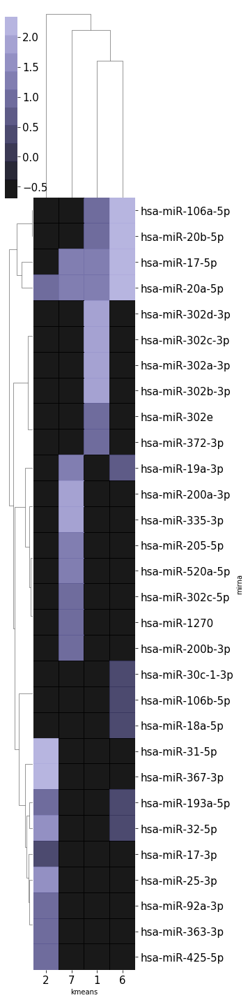

In [167]:
def miRNA_enrichment_heatmap(df, chord, color, kmeans_liste, label):
    """
    function to retrieve the miRNA with the most targets within each of the clusters
    df -> enrichment hubs 
    chord -> the hub-gene miRNA database
    color -> module color
    kmeans_liste -> select the important modules
    label -> saving the results
    """
    df_genes = df[df["kmeans"].isin(kmeans_liste)]["Unnamed: 0"].tolist()
    chord_genes = chord[chord["gene_name"].isin(df_genes)
                        & (chord["cluster_gene"] == color)]
    print(chord_genes)
    chord_genes = chord_genes[["gene_name", "mirna", "cluster_gene"]]
    chord_genes = pd.merge(chord_genes,
                           df,
                           how="left",
                           left_on="gene_name",
                           right_on="Unnamed: 0")
    chord_genes = chord_genes.set_index("cluster_gene")
    trial = chord_genes["mirna"].groupby(chord_genes["kmeans"]).value_counts()
    trial = trial.groupby(level=0).nlargest(10)

    trial.columns = ["counts"]
    trial = trial.groupby(["kmeans", "mirna"]).sum().unstack()
    trial = trial.fillna(0)
    sns.clustermap(trial.T,
                   figsize=(5, 20),
                   cmap=sns.cubehelix_palette(10,
                                              start=9,
                                              rot=0,
                                              dark=0,
                                              light=.7,
                                              reverse=True),
                   alpha=0.9,
                   row_cluster=True,
                   col_cluster=True,
                   z_score=1)
    plt.savefig(label + "mirnas_enriched.svg",
                quality=90,
                dpi=600,
                transparent=True,
                bbox_inches="tight")


miRNA_enrichment_heatmap(enr_hub[4], hub_chord, "violet", [1, 2, 6, 7],
                         "violet_cluster_")

In [21]:
def get_mirna_networks(expression, all_hubs, genes_count, module_color,
                       module_kmeans):
    """ add docstrings to the Function"""
    module_hubs = all_hubs.iloc[:30, :]["external_gene_name"].tolist()
    module_expression = expression[expression.index.isin(
        module_hubs)].iloc[:, 3:-1]
    module_corr = module_expression.T.corr()
    stack_module = pd.DataFrame(module_corr.stack())
    stack_module.index.set_names(["source", "target"], inplace=True)
    stack_module = stack_module.reset_index()
    stack_module.columns = ["source", "target", "score"]
    stack_module = stack_module[stack_module["score"] != 1]
    fig, ax = plt.subplots(figsize=(10, 10))
    module_net = nx.from_pandas_edgelist(stack_module, "source", "target",
                                         "score")
    genes_count = genes_count.set_index("Unnamed: 0")
    score = [
        genes_count[genes_count.index == i]["gene_name"].tolist()[0]
        for i in module_net.nodes
    ]
    nx.draw_spring(module_net,
                   with_labels=True,
                   node_color="red",
                   node_size=[i * 100 for i in score],
                   edge_color="grey",
                   font_size=18,
                   alpha=0.8)
    plt.tight_layout()
    plt.title(module_color + "-" + str(module_kmeans))
    plt.savefig(module_color + str(module_kmeans) + "_mirna_module_hubs.svg",
                dpi=600,
                transparent=True,
                quality=90,
                bbox_inches="tight")

     gene_name      UMAP1     UMAP2 supercluster_gene cluster_gene  kmeans
761       AAK1  10.946392  7.150816        nociceptor          red       1
762       ABAT  10.488161  7.701448        nociceptor       yellow       1
763     ABCA10  10.779952  6.196337        nociceptor    turquoise       1
764      ABCC5  10.952252  6.198928        nociceptor    turquoise       1
765    ABHD14B  10.091355  7.945308        nociceptor    turquoise       1
...        ...        ...       ...               ...          ...     ...
1397    ZNF697  10.594271  7.503685        nociceptor       violet       1
1398    ZNF711  11.275145  6.524797        nociceptor         cyan       1
1399    ZNF800  11.329849  6.512050        nociceptor   lightgreen       1
1400    ZSWIM5  10.971508  6.084136        nociceptor          red       1
1401    ZYG11B  10.988961  5.969868        nociceptor      skyblue       1

[641 rows x 6 columns]
142
15
137
2
18
9
12
10
156
38
20
35
19
1
6
11
10
     gene_name     UMAP1  

/Users/maximilianzeidler/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


6
9
2
5
3
3
1
2
1
2
88
5
9
6
5
2
2
6
9
5
4
8
17
3
2
182
14
2
1
20
152
4
23
2
12
19
11
8
3
39
35
38
     gene_name     UMAP1     UMAP2        supercluster_gene cluster_gene  \
4760     ABCG4  8.898231  9.578462               nociceptor       yellow   
4761     ACBD5  8.802181  9.581513               nociceptor      bisque4   
4762     ACSL1  8.475564  9.470566               nociceptor       yellow   
4763   ADAMTS1  8.553677  9.710909               nociceptor    turquoise   
4764     ADCY9  8.344495  9.491231  pluripotency/maturation       orange   
...        ...       ...       ...                      ...          ...   
5004   UBE2QL1  8.263688  9.571843               nociceptor       yellow   
5005     YPEL2  8.940565  9.507980               nociceptor       yellow   
5006   ZDHHC23  8.405580  9.349505  pluripotency/maturation       orange   
5007     ZMYM6  8.268909  9.561421               nociceptor    turquoise   
5008    ZNF33A  8.870981  9.361212               nociceptor      

/Users/maximilianzeidler/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


1
2
18
40
4
5
24
4
10
10
3
37
     gene_name     UMAP1      UMAP2 supercluster_gene cluster_gene  kmeans
5009     AADAT  3.336860  10.940405        nociceptor    turquoise       7
5010  AASDHPPT  3.932791  12.506349        nociceptor          red       7
5011     ABCA3  4.911274   9.927440        nociceptor          red       7
5012     ABCA5  2.888557  10.268966        nociceptor    turquoise       7
5013    ABCB10  3.993313  12.251827        nociceptor   lightgreen       7
...        ...       ...        ...               ...          ...     ...
5926     ZNF84  2.877347  10.630631        nociceptor         pink       7
5927    ZNF843  3.890819  11.575258        nociceptor          red       7
5928    ZNF853  4.754893   9.711460        nociceptor       yellow       7
5929    ZNF862  2.902942  10.538635        nociceptor         pink       7
5930    ZSWIM6  2.289180  11.363968        nociceptor       purple       7

[922 rows x 6 columns]
2


/Users/maximilianzeidler/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


42
10
53
1
172
40
11
2
3
74
22
1
126
48
222
3
36
29
5
17
3


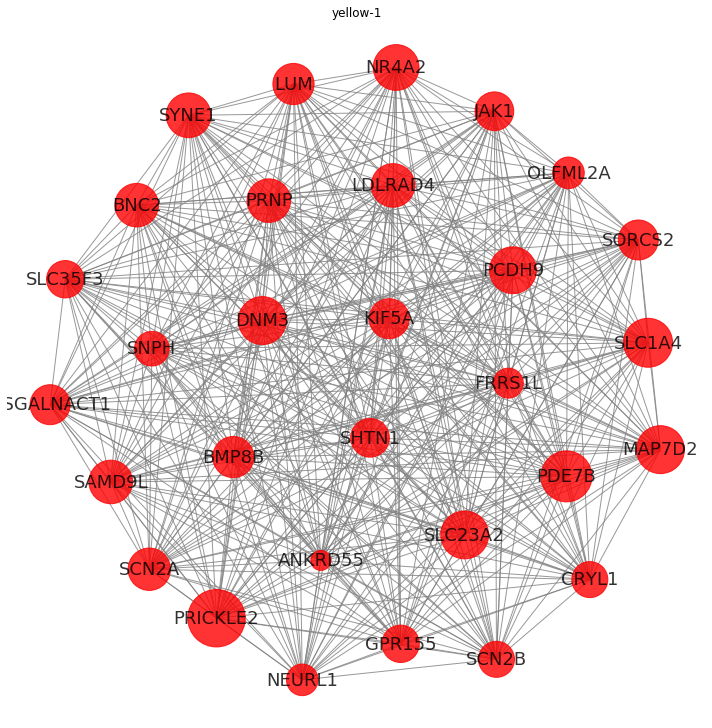

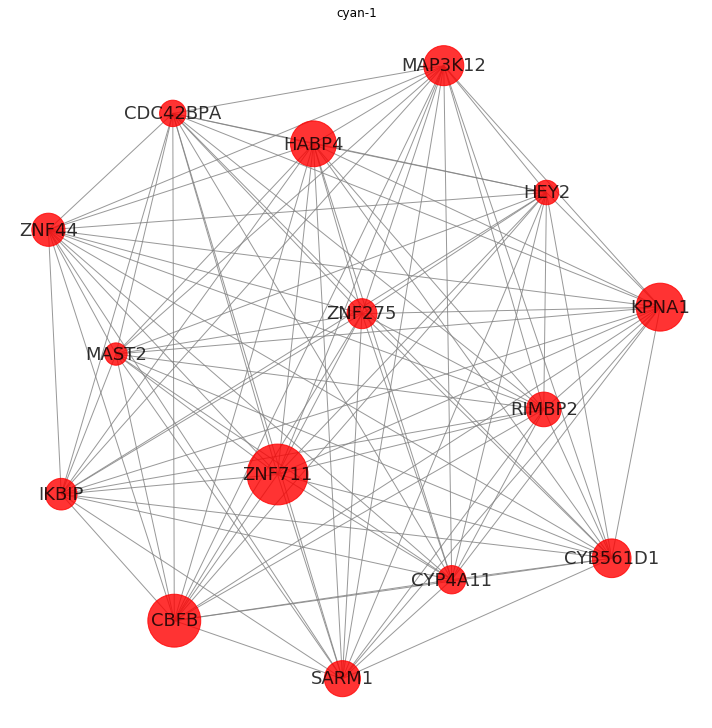

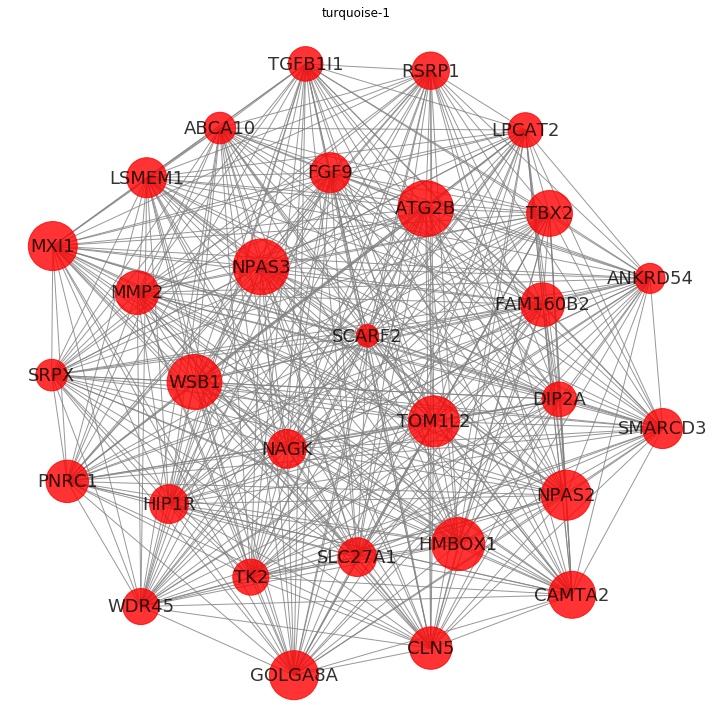

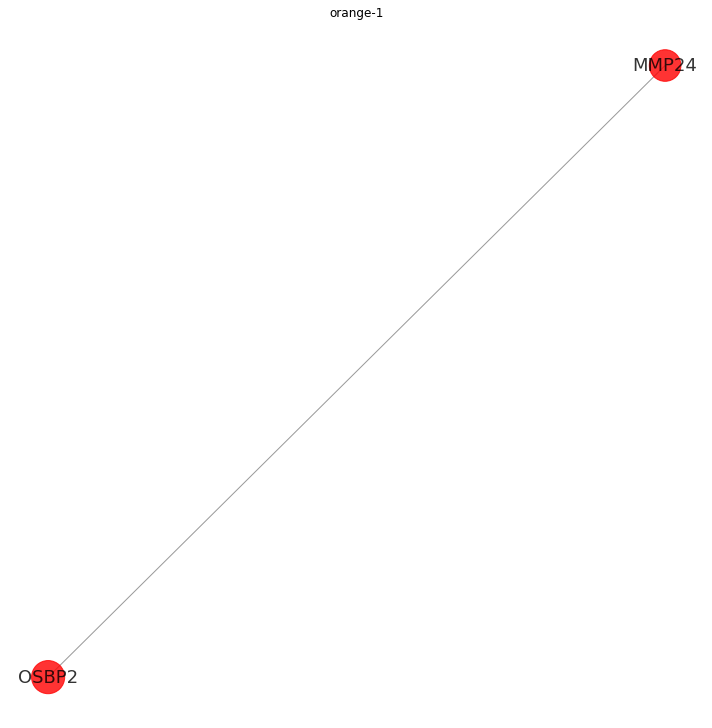

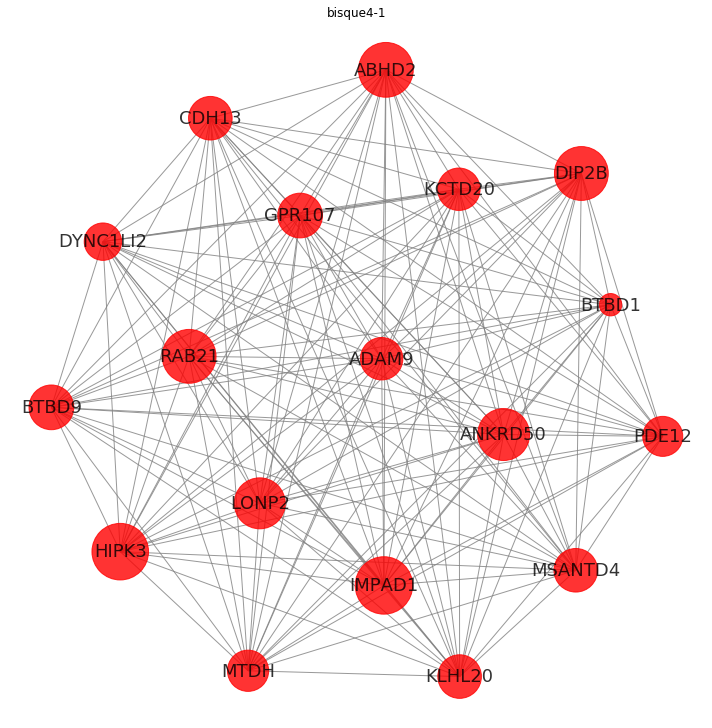

...

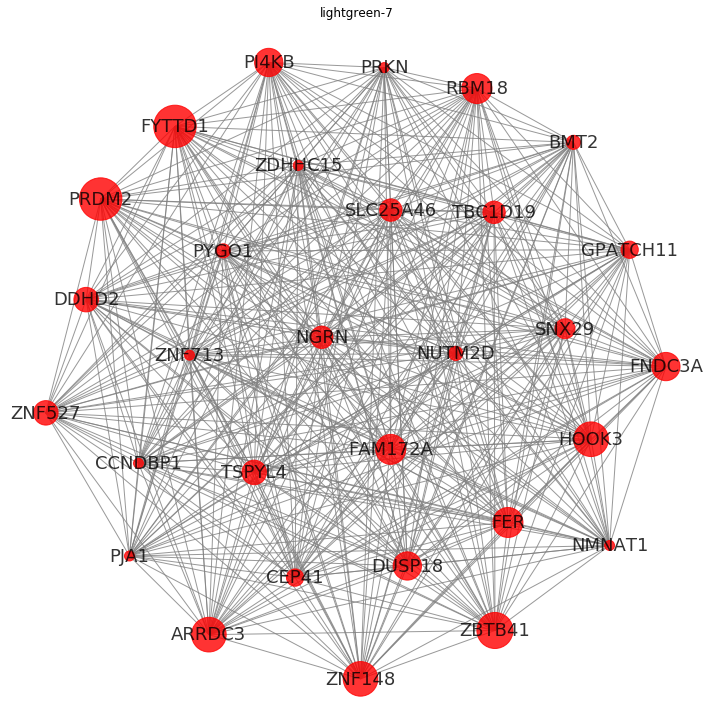

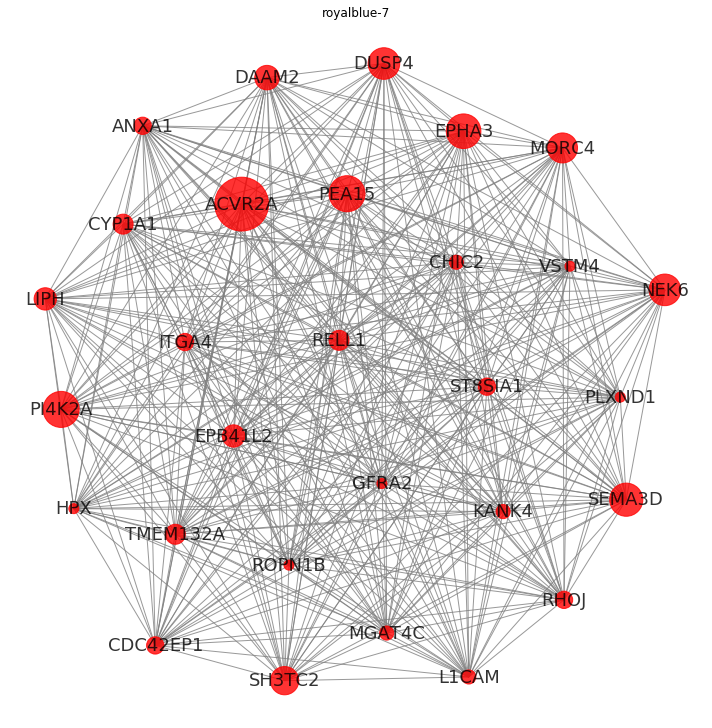

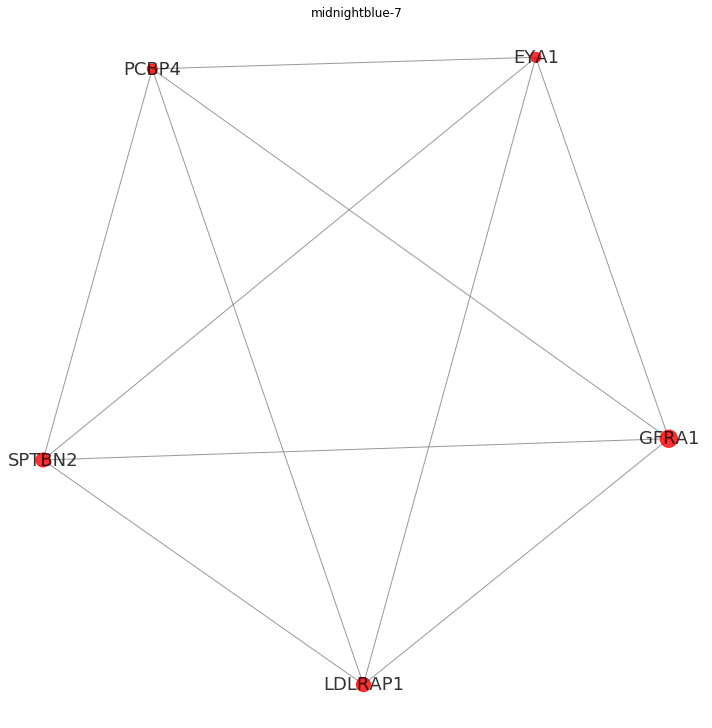

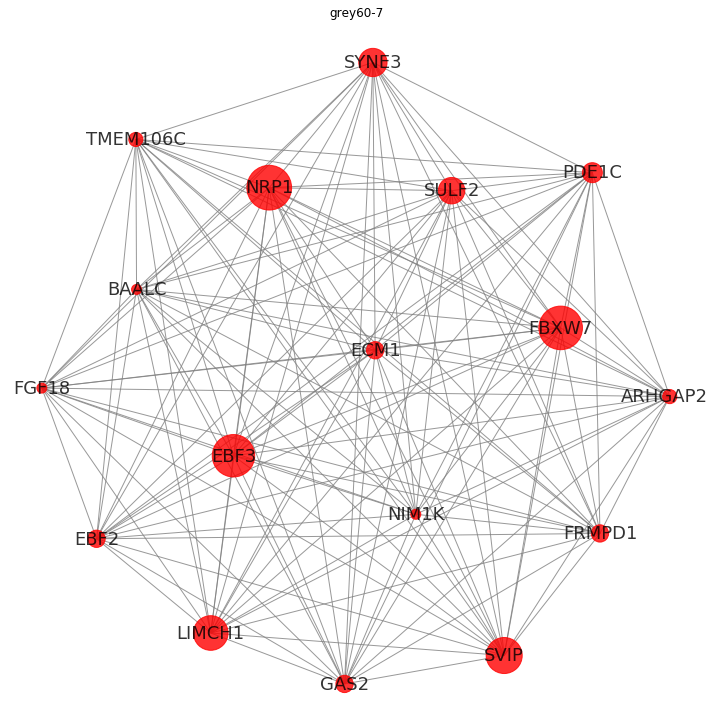

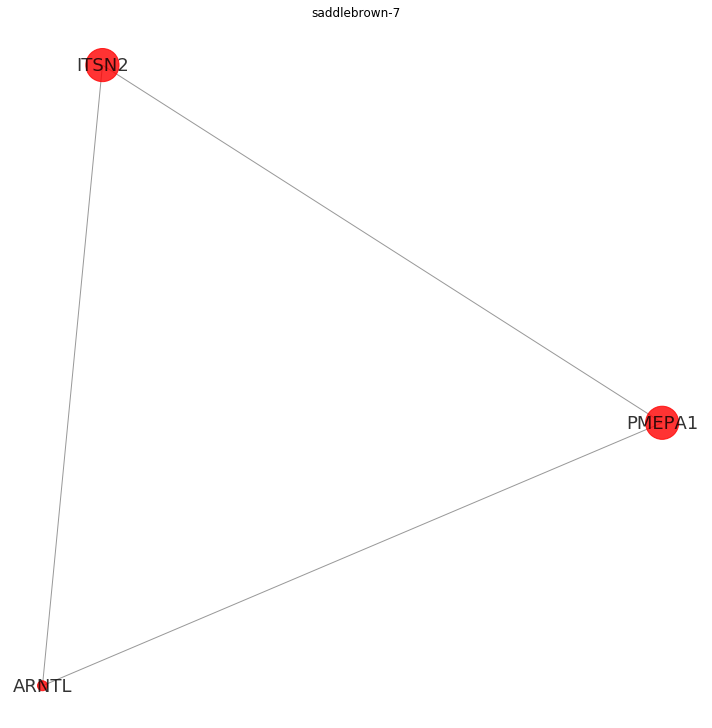

In [22]:
import time
clusters_numb = [1, 2, 6, 7]


def cluster_hubs_mirna(df, module_hubs, genes_count, genes_list):
    enrichment_all_cluster = pd.DataFrame()
    for t in genes_list:
        df_hub = df[df["kmeans"] == t]
        print(df_hub)
        for i in set(df_hub["cluster_gene"].tolist()):
            time.sleep(1)
            df_hub_mir = df_hub[df_hub["cluster_gene"] == i]
            df_hub_mir = df_hub_mir.set_index("gene_name")
            enrichment_per_cluster = mirna_analysis_div(df_hub_mir, "hsapiens")
            genes_liste = df_hub_mir.index.tolist()
            enrichment_per_cluster[
                "cluster"] = enrichment_per_cluster.shape[0] * [i]
            enrichment_per_cluster[
                "kmeans"] = enrichment_per_cluster.shape[0] * [t]
            enrichment_all_cluster = enrichment_all_cluster.append(
                enrichment_per_cluster)
            modules_hub = module_hubs[module_hubs["external_gene_name"].isin(
                genes_liste)]
            modules_hub = modules_hub.sort_values(
                ["kME.set1.ME", "kME.set2.ME", "kME.set3ME"], ascending=False)
            get_mirna_networks(mrna_genes, modules_hub, genes_count, i, t)
    return enrichment_all_cluster


enrichment_analysis = cluster_hubs_mirna(enr_hub[1], module_hubs, enr_hub[4],
                                         clusters_numb)

In [23]:
enrichment_analysis.to_csv("mirna_analysis_enrichments_hubs.csv")

In [26]:
def mirna_gene_expression(gene, mirna, gene_expression, mirna_expression):
    """ function to detect the miRNA::hubgene correlation between the cluster and draw
    te line plots"""
    gene = gene.set_index("Unnamed: 0")
    mirna = mirna.set_index("Unnamed: 0")
    for i in [1, 2, 6, 7]:
        columns = [
            "D0", "D0", "D0", "D5", "D5", "D5", "D9", "D9", "D9", "D16", "D16",
            "D16", "D26", "D26", "D26", "D36", "D36", "D36"
        ]
        genes_list = gene[gene["kmeans"] == i].index.tolist()
        mirna_list = mirna[mirna["kmeans"] == i].index.tolist()
        mirna_exp = mirna_expression[mirna_expression["Row.names"].isin(
            mirna_list)].set_index("Row.names").iloc[:, 1:-1]
        gene_exp = gene_expression[gene_expression.index.isin(
            genes_list)].iloc[:, 2:-1]
        print(gene_exp)
        mirna_exp.columns = columns
        gene_exp.columns = columns
        palette_mirna = ["pink"] * mirna_exp.shape[0]
        palette_gene = ["green"] * gene_exp.shape[0]
        mirna_mean = mirna_exp.mean(axis=0)
        gene_mean = gene_exp.mean(axis=0)
        print(gene_mean)
        fig, ax = plt.subplots()
        sns.lineplot(data=mirna_exp.T,
                     palette=palette_mirna,
                     dashes=False,
                     sort=False,
                     legend=False)
        sns.lineplot(data=mirna_mean.T,
                     palette=["black"],
                     dashes=False,
                     sort=False,
                     legend=False)
        sns.lineplot(data=gene_exp.T,
                     palette=palette_gene,
                     dashes=False,
                     sort=False,
                     legend=False)
        sns.lineplot(data=gene_mean.T,
                     palette=["black"],
                     dashes=False,
                     sort=False,
                     legend=False)
        plt.title(str(i) + "lineplot")
        plt.savefig(str(i) + "_plotted_curves.svg",
                    quality=90,
                    transparent=True,
                    dpi=600,
                    bbox_inches="tight")

                           0         1         2         3         4  \
external_gene_name                                                     
ABHD2              -0.792052 -0.788651 -0.791197 -1.252975 -0.995066   
ADAM9              -0.524479 -0.279457 -0.367693 -1.149597 -0.639026   
ANKRD50            -0.519255 -0.687066 -0.531508 -1.629260 -1.067446   
BTBD1              -0.347385 -0.213389 -0.234761 -1.843760 -1.305070   
BTBD9              -1.764730 -1.875142 -1.926386 -0.581031 -0.390234   
...                      ...       ...       ...       ...       ...   
SOGA1              -1.898469 -2.048215 -2.042033 -0.300325 -0.124101   
SSH2               -1.776430 -1.871576 -1.920440 -0.786589 -0.386706   
STK40              -1.255721 -1.183820 -1.071968 -1.317666 -1.428984   
ZFP30              -1.937001 -1.943864 -2.031873 -0.612612 -0.063750   
ZHX3               -1.351772 -1.482969 -1.401189 -1.331831 -0.969929   

                           5         6         7         8     

                           0         1         2         3         4  \
external_gene_name                                                     
ATP7A              -1.354996 -1.334520 -1.348021 -1.339200 -1.046029   
C6orf89            -1.410284 -1.408501 -1.331783 -1.090130 -0.536000   
EDEM3              -1.481033 -1.487516 -1.419198 -1.067738 -0.434760   
LMBRD2             -1.465915 -1.078361 -1.489138 -1.341889 -0.706098   
MBTPS2             -1.149358 -0.951518 -1.202528 -1.615061 -0.701467   
...                      ...       ...       ...       ...       ...   
VPS29              -1.402152 -1.392742 -1.780199 -0.995563 -0.926197   
ZEB1               -2.235012 -2.146909 -2.069453 -0.095056 -0.020259   
ZHX1               -1.870442 -1.919945 -1.880681 -0.805825 -0.534560   
ZMIZ1              -2.009381 -2.065597 -2.055421 -0.300605 -0.311630   
ZNF764             -1.613055 -1.329625 -1.629928 -0.337427 -0.943507   

                           5         6         7         8     

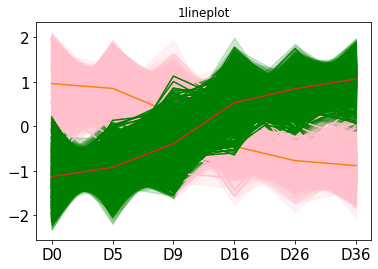

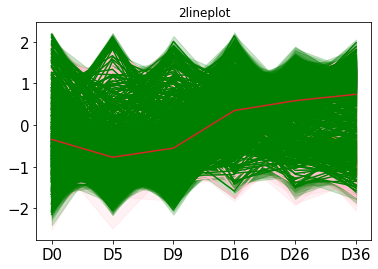

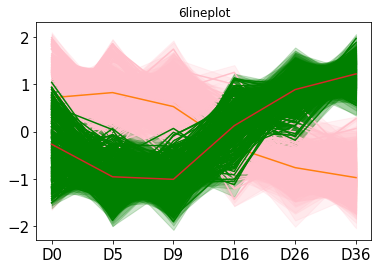

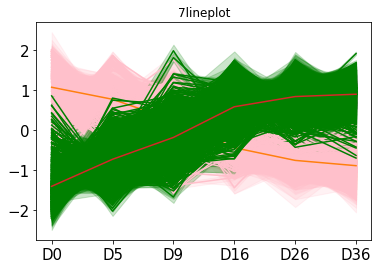

In [27]:
mirna_gene_expression(enr_hub[4],enr_hub[3], mrna_genes, mirna)

          Unnamed: 0  cluster_gene  kmeans
9                red           156       1
10            yellow           142       1
11         turquoise           137       1
12            purple            38       1
13            violet            35       1
14         royalblue            20       1
15         lightcyan            19       1
16           bisque4            18       1
17              cyan            15       1
18        lightgreen            12       1
26            yellow           182       2
27         turquoise           152       2
28               red            88       2
29            grey60            39       2
30       saddlebrown            38       2
31             brown            35       2
32            orange            23       2
33              cyan            20       2
34         royalblue            19       2
35            violet            17       2
133           yellow            91       6
134        turquoise            40       6
135      sa

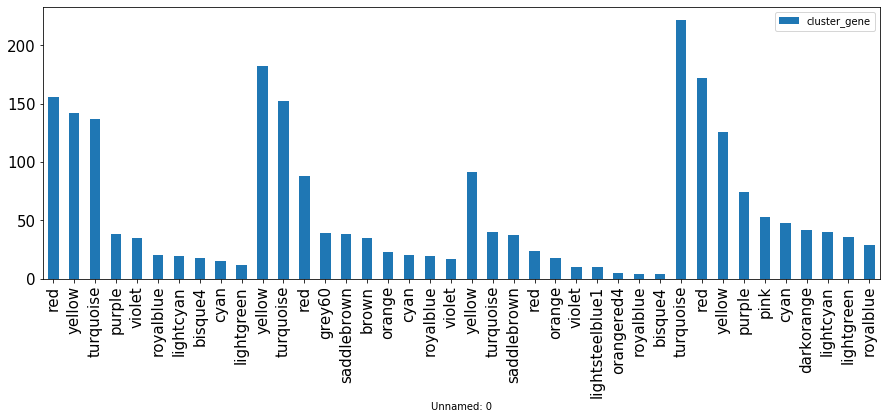

In [33]:
clusters_numb = [
    1, 2, 6, 7
]  # take here the clusters that are associated with late stage differentiation
cluster = enr_hub[2]
cluster_noci = cluster[cluster["kmeans"].isin(clusters_numb)]


def barplot_clusters(df, label, label_2):
    """draw the number of targets per gene module or miRNA"""
    cluster_enr = pd.DataFrame()
    for i in set(df["kmeans"]):
        df_bar = df[df["kmeans"] == i]
        df_bar = df_bar.sort_values(label_2, ascending=False).iloc[:10, :]
        cluster_enr = cluster_enr.append(df_bar)
    print(cluster_enr)
    cluster_enr.set_index("Unnamed: 0").iloc[:, :1].plot(kind="bar",
                                                         figsize=(15, 5))
    plt.savefig(label,
                quality=90,
                dpi=500,
                transparent=True,
                bbox_inches="tight")


barplot_clusters(cluster_noci, "cluster_targets_miRNA.svg", "cluster_gene")

           Unnamed: 0  mirna  kmeans
187   hsa-miR-302c-3p    640       1
188   hsa-miR-302a-3p    639       1
189   hsa-miR-302d-3p    635       1
190   hsa-miR-302b-3p    633       1
191    hsa-miR-372-3p    526       1
192      hsa-miR-302e    447       1
193    hsa-miR-373-3p    414       1
194   hsa-miR-520a-3p    337       1
195    hsa-miR-20a-5p    328       1
196     hsa-miR-17-5p    315       1
399    hsa-miR-18a-5p     91       2
400     hsa-miR-25-3p     91       2
401     hsa-miR-31-5p     89       2
402    hsa-miR-335-5p     88       2
403    hsa-miR-15b-5p     88       2
404    hsa-miR-92a-3p     82       2
405    hsa-miR-363-3p     82       2
406    hsa-miR-367-3p     72       2
407     hsa-miR-32-5p     59       2
408   hsa-miR-103a-3p     56       2
1217  hsa-miR-106a-5p    248       6
1219   hsa-miR-20b-5p    245       6
1218   hsa-miR-20a-5p    245       6
1220    hsa-miR-17-5p    237       6
1221  hsa-miR-106b-5p    149       6
1222    hsa-miR-93-5p     85       6
1

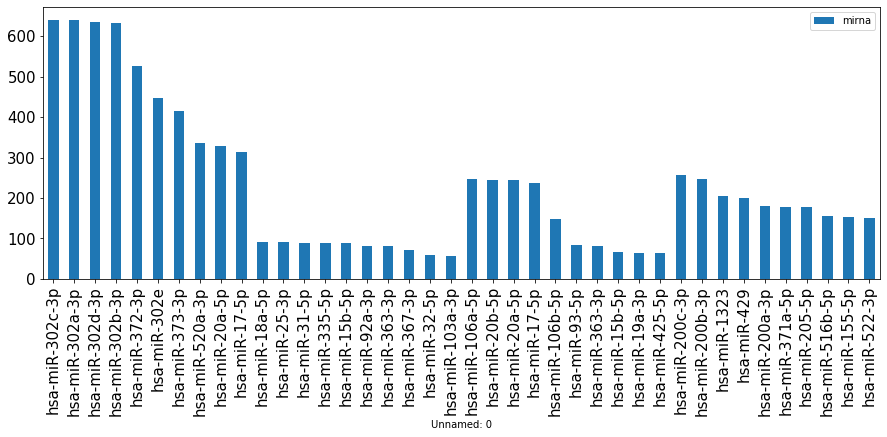

In [36]:
barplot_clusters(enr_hub[3][enr_hub[3]["kmeans"].isin(clusters_numb)],
                 "mirna_numbers.svg", "mirna")

In [40]:
enr_hub[1]

,gene_name,UMAP1,UMAP2,supercluster_gene,cluster_gene,kmeans
0,AAMP,-0.108887,4.528653,pluripotency,brown,0
1,ABCC1,0.212955,4.449003,early differentiation,blue,0
2,ABCE1,-0.736160,3.053945,early differentiation,blue,0
3,ABHD17B,-0.894114,4.717859,early differentiation,blue,0
4,ABRACL,-0.766399,3.035834,early differentiation,blue,0
...,...,...,...,...,...,...
5926,ZNF84,2.877347,10.630631,nociceptor,pink,7
5927,ZNF843,3.890819,11.575258,nociceptor,red,7
5928,ZNF853,4.754893,9.711460,nociceptor,yellow,7
5929,ZNF862,2.902942,10.538635,nociceptor,pink,7


In [16]:
# Eigenvector centrality for the miRNA::hub-gene interaction networks using network
import networkx as nx
import community
import math


def draw_network_get_degree(df1_diana):
    H = nx.from_pandas_edgelist(df1_diana, "mirna", "gene_name", "score")
    fig, ax = plt.subplots()
    nx.draw_spring(H, with_labels=True)
    phi = (1 + math.sqrt(5)) / 2.0
    centrality_all = nx.eigenvector_centrality_numpy(H, "score")
    return centrality_all